In [2]:
from pymsaviz import MsaViz
from Bio import SeqIO
from Bio.Seq import Seq
from Bio.SeqRecord import SeqRecord
from Bio.Align import MultipleSeqAlignment

import pandas as pd
import numpy as np

import os
import matplotlib.pyplot as plt

In [3]:
def lighten_color(color, amount=0.5):
    """
    Lightens the given color by multiplying (1-luminosity) by the given amount.
    Input can be matplotlib color string, hex string, or RGB tuple.

    Examples:
    >> lighten_color('g', 0.3)
    >> lighten_color('#F034A3', 0.6)
    >> lighten_color((.3,.55,.1), 0.5)
    """
    import matplotlib.colors as mc
    import colorsys
    try:
        c = mc.cnames[color]
    except:
        c = color
    c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    
    return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])


def get_fasta_df(fasta_path):
    seqs = []
    for record in SeqIO.parse(fasta_path, "fasta"):
        seqs.append([record.id, record.id.replace("_", " "), record.seq])
    
    df = pd.DataFrame(seqs, columns=['id', 'name', 'seq'])

    return df




def write_fasta(seqrecord_list, fasta_path):

    with open(fasta_path, "w") as output_handle:
        SeqIO.write(seqrecord_list, output_handle, "fasta")
        
    return
        

In [3]:
# sort msa files for vis into same order as phylogenetic tree:
# rooted_bsap_tree = "final_nt_workflow/bsap_nt_subset47_consensus_tree.nwk.rooted"
# rooted_bsap_tree = "final_nt_workflow/bsap_nt_subset50_rooted_species_order.txt"

rooted_bsap_tree = "motif/putative2_biob_independent_seqs_consensus_tree.nwk"

file = open(rooted_bsap_tree, 'r')
nwk = file.readline()

file.close()

FileNotFoundError: [Errno 2] No such file or directory: 'motif/putative2_biob_independent_seqs_consensus_tree.nwk'

In [99]:
# species_order = pd.Series(nwk.split(",")).str.rstrip("\n").str.replace("_", " ").tolist()

species_order = pd.Series(nwk.split(",")).str.rstrip("\n"
    ).str.replace("_", " ").str.replace("(", " ").str.replace(")", " ").str.split(":", expand=True)[0].str.strip().tolist()

In [100]:
species_order

0      Ornithinimicrobium tianjinense strain CGMCC 1....
1      Sphaerimonospora thailandensis strain NBRC 107569
2                              Conexibacter sp. Seoho-28
3                  Conexibacter arvalis strain DSM 23288
4                   Nitriliruptor alkaliphilus DSM 45188
                             ...                        
335             Planobispora takensis strain NBRC 109077
336            Planobispora siamensis strain NBRC 107568
337    Thermocatellispora tengchongensis strain DSM 4...
338       Actinoallomurus bryophytorum strain DSM 102200
339      Thermostaphylospora chromogena strain DSM 43794
Name: 0, Length: 340, dtype: object

## BioB figures:

In [82]:
msa_path = "final_nt_workflow/biob_protein_sequences_subset50_WITH_OUTGROUP.3.mfa"
seqs = []

for record in SeqIO.parse(msa_path, "fasta"):
    seqs.append([record.id, record.id.replace("_", " "), record.seq])

msa = pd.DataFrame(seqs, columns=['id', 'name', 'seq'])

In [110]:
seqs_sorted = []

for i in species_order:
    seqs_sorted.append(SeqRecord(msa.loc[msa['name'] == i, 'seq'].item(), id=msa.loc[msa['name'] == i, 'name'].item(), description=""))
    # msa

In [113]:
len(seqs_sorted)

50

In [115]:
biob_mfa_sorted_no_outgroup_path = "final_nt_workflow/biob_protein_sequences_subset50_NO_OUTGROUP.sorted.3.mfa"

with open(biob_mfa_sorted_no_outgroup_path, "w") as output_handle:
    SeqIO.write(seqs_sorted, output_handle, "fasta")

In [116]:
msa.head()

,id,name,seq
0,Streptococcus_agalactiae_UMB0866,Streptococcus agalactiae UMB0866,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
1,Staphylococcus_epidermidis_BCM-HMP0060,Staphylococcus epidermidis BCM-HMP0060,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
2,Staphylococcus_delphini_8086,Staphylococcus delphini 8086,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
3,Escherichia_coli_strain_CFT073,Escherichia coli strain CFT073,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
4,Lachnospiraceae_bacterium_SUG1049,Lachnospiraceae bacterium SUG1049,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."


In [132]:
h37rv_seq = msa.loc[msa['id'] == 'Mycobacterium_tuberculosis_H37Rv', 'seq'].item()
h37rv_seq

Seq('--VTQAATRPTNDAGQDGGNNSDILVVARQQVLQRGEGLNQDQVLAVLQLPDDR...---')

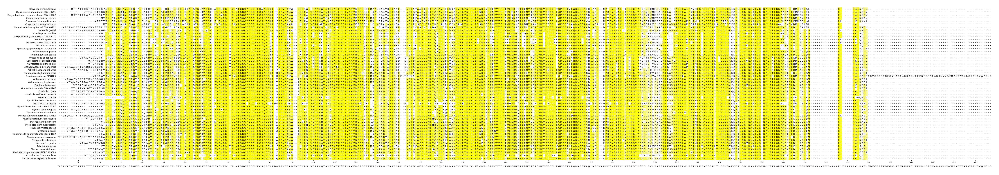

In [129]:
main_msa_path = "final_nt_workflow/biob_protein_sequences_subset50_NO_OUTGROUP.sorted.3.mfa"

mv = MsaViz(main_msa_path, label_type='description', show_consensus=True, consensus_size=0, color_scheme="Identity")

# def custom_color_func(
#     row_pos: int, 
#     col_pos: int, 
#     seq_char: str, 
#     msa: MultipleSeqAlignment
# ):

#     if (seq_char == h37rv_seq[col_pos]) & (seq_char != "-"):
#     # Note: Both `row_pos` and `col_pos` are 0-index starts
#         # return "salmon"
#         return "lightblue"
    
#     # Use default color setting in other column (145 <= col_pos < 160)
#     return "white"

# mv.set_custom_color_func(custom_color_func)

mv.set_highlight_pos_by_ident_thr(min_thr=50)
mv.set_plot_params(identity_color="yellow")

# fig = mv.plotfig()

mv.savefig("msa_figs/biob_protein_subset50_consensus_highlight_msa.png")

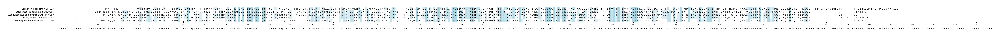

In [131]:
outgroup_msa_path = "final_nt_workflow/biob_protein_sequences_subset50_OUTGROUP.3.mfa"

mv = MsaViz(outgroup_msa_path, label_type='description', show_consensus=True, consensus_size=0, color_scheme="Identity")

# def custom_color_func(
#     row_pos: int, 
#     col_pos: int, 
#     seq_char: str, 
#     msa: MultipleSeqAlignment
# ):

#     if (seq_char == h37rv_seq[col_pos]) & (seq_char != "-"):
#     # Note: Both `row_pos` and `col_pos` are 0-index starts
#         # return "salmon"
#         return "lightblue"
    
#     # Use default color setting in other column (145 <= col_pos < 160)
#     return "white"

# mv.set_custom_color_func(custom_color_func)
mv.set_highlight_pos_by_ident_thr(min_thr=50)
mv.set_plot_params(identity_color="lightblue")

# fig = mv.plotfig()
mv.savefig("msa_figs/biob_protein_outgroup_msa.png")

## BsaP figure:

In [50]:
## generate subset42 protein fasta subset:
sub42 = pd.read_csv("final_nt_workflow/bsap_nt_subset42_species.csv")

In [77]:
seqs = get_fasta_df("final_nt_workflow/bsap_protein_sequences_subset47.fa")

In [81]:
seqs.loc[seqs['id'] == 'Pseudonocardia_sp._MAG106', 'name'] = 'Pseudonocardia sp. MAG106*'

In [82]:
seqs = seqs[seqs['name'].isin(sub42['0'])]

In [86]:
seqs.loc[2, 'seq']

Seq('MPPSEPPRWPAPPKRPASRELAEAHLLGDPGRFDPFTGADLAAGEERARSHSAR...ERR')

In [89]:
seqs.head()

,id,name,seq
0,Rhodococcus_yunnanensis_NBRC_103083,Rhodococcus yunnanensis NBRC 103083,"(V, T, S, E, E, R, Y, N, P, F, T, G, Q, P, V, ..."
1,Actinophytocola_xinjiangensis,Actinophytocola xinjiangensis,"(M, Y, C, V, H, C, G, V, P, P, A, E, G, D, H, ..."
2,Corynebacterium_sphenisci_DSM_44792,Corynebacterium sphenisci DSM 44792,"(M, P, P, S, E, P, P, R, W, P, A, P, P, K, R, ..."
3,Corynebacterium_aquilae_DSM_44791,Corynebacterium aquilae DSM 44791,"(M, R, I, P, D, C, D, D, L, L, V, A, M, V, T, ..."
4,Mycolicibacterium_iranicum,Mycolicibacterium iranicum,"(M, V, T, D, S, T, E, L, P, A, P, V, G, A, G, ..."


In [285]:
records = []

for i in seqs.index:
   
    records.append(SeqRecord(
        seqs.loc[i, 'seq'], 
        id=seqs.loc[i, 'id'],
        # id=seqs.loc[i, 'id'], 
        description=""))

write_fasta(records, "final_nt_workflow/bsap_protein_sequences_subset42.fa")


In [288]:
msa

,id,name,seq
0,Corynebacterium_falsenii,Corynebacterium falsenii,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
1,Corynebacterium_phoceense,Corynebacterium phoceense,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
2,Corynebacterium_sphenisci_DSM_44792,Corynebacterium sphenisci DSM 44792,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
3,Corynebacterium_gallinarum,Corynebacterium gallinarum,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
4,Corynebacterium_silvaticum,Corynebacterium silvaticum,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
5,Corynebacterium_argentoratense_DSM_44202,Corynebacterium argentoratense DSM 44202,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
6,Corynebacterium_aquilae_DSM_44791,Corynebacterium aquilae DSM 44791,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
7,Tomitella_gaofuii,Tomitella gaofuii,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
8,Kribbella_speibonae,Kribbella speibonae,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
9,Kribbella_flavida_DSM_17836,Kribbella flavida DSM 17836,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."


In [291]:
# tree = "final_nt_workflow/bsap_nt_subset47_consensus_tree.nwk.rooted"
tree = "final_nt_workflow/bsap_nt_sequences_subset41_consensus_tree.nwk.rooted"

file = open(tree, 'r')
nwk = file.readline()
file.close()

species_order = pd.Series(nwk.split(",")).str.rstrip("\n"
    ).str.replace("_", " ").str.replace("(", " ").str.replace(")", " ").str.split(":", expand=True)[0].str.strip().tolist()


# msa_path = "final_nt_workflow/bsap_protein_sequences_subset47_edit.mfa"
# sorted_msa_output_path = "final_nt_workflow/bsap_protein_sequences_subset47.sorted.mfa"
msa_path = "final_nt_workflow/bsap_protein_sequences_subset41.msa"
sorted_msa_output_path = "final_nt_workflow/bsap_protein_sequences_subset41.sorted.msa"
seqs = []

for record in SeqIO.parse(msa_path, "fasta"):
    seqs.append([record.id, record.id.replace("_", " "), record.seq])

msa = pd.DataFrame(seqs, columns=['id', 'name', 'seq'])


seqs_sorted = []

for i in species_order:
    seq = Seq(msa.loc[msa['name'] == i, 'seq'].item())
    seq_id = msa.loc[msa['name'] == i, 'name'].item()
    
    seqs_sorted.append(SeqRecord(seq, id=seq_id, description=""))


with open(sorted_msa_output_path, "w") as output_handle:
    SeqIO.write(seqs_sorted, output_handle, "fasta")
    

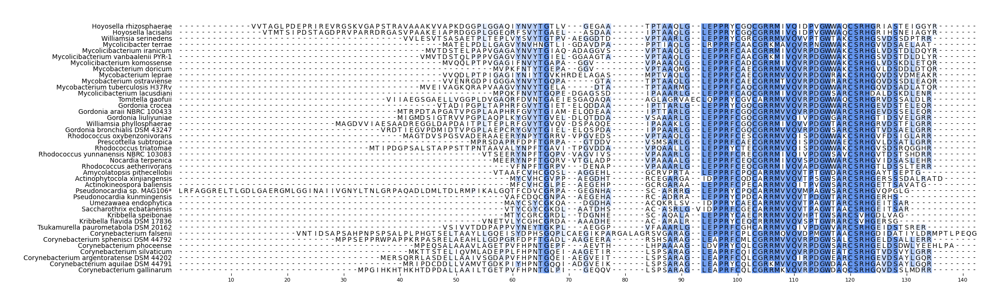

In [292]:
mv = MsaViz(sorted_msa_output_path, label_type='description', show_consensus=False, color_scheme="Identity",)
           # start=15, end=150,) 
            # show_seq_char=False, show_grid=True)

# mv.set_highlight_pos_by_ident_thr(min_thr=30)
# mv.set_plot_params(identity_color="cornflowerblue", x_unit_size=0.05, y_unit_size=0.1, identity_color_min_thr=10)
mv.set_plot_params(identity_color="cornflowerblue", x_unit_size=0.12, y_unit_size=0.13, identity_color_min_thr=10)

# fig = mv.plotfig()

mv.savefig("msa_figs/bsap_aa_subset41_consensus_highlight_msa.png")

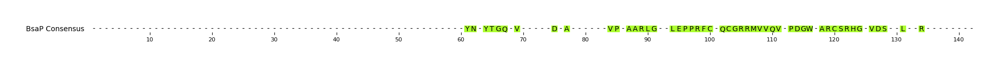

In [293]:

mv = MsaViz("final_nt_workflow/bsap_protein_sequences_subset41_emboss_consensus.fa", label_type='description', show_consensus=False, color_scheme="Identity",
            # start=1, end=100,
            show_grid=False)

# mv.set_highlight_pos_by_ident_thr(min_thr=30)
mv.set_plot_params(identity_color="greenyellow", x_unit_size=0.12, y_unit_size=0.13, identity_color_min_thr=90)


# mv.set_custom_color_func(diff_consensus_color_func)
# fig = mv.plotfig()
mv.savefig("final_nt_workflow/bsap_protein_subset41_consensus.png")

In [779]:
lens = []

for i in msa.index:
    lens.append(len(msa.loc[i, 'seq']))

pd.Series(lens).value_counts()

145    46
Name: count, dtype: int64

In [109]:
consensus42 =  "nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnATGnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnCnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnncgnnnCnGnnGnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnTACnACGtCTACACCGGnnnnCnnnTCGnCGnnGnnGnnnnnnnnnnnnnnnTgCCGnCnGCgnnnnnnnnnnnnnnnnnnnnnnnnnnGCnCGGCTnGnnnnnnGnCnTGGAGCCGCCGCGGTTCTGCGnGCAGTGCGGnCGCCGGATGGTCGTGCAGGTCnGnCCGGACGGCTGGTGGGCgCGGTGCTCnCGnCACGGnGnnnnGnTCGACTCGnCnnnnGAnCTGnnnnnnnnnnnnnnnnnnnnnGnnCAnCGnTGAn" 
consensus42 = consensus42.upper().replace("N", "-")

In [110]:
len(consensus42)

473

In [111]:
consensus42

'---------------------------------------------------------ATG-----------------------------------------C-----------------------------------------CG---C-G--G---------------------------------------------------------TAC-ACGTCTACACCGG----C---TCG-CG--G--G---------------TGCCG-C-GCG--------------------------GC-CGGCT-G------G-C-TGGAGCCGCCGCGGTTCTGCG-GCAGTGCGG-CGCCGGATGGTCGTGCAGGTC-G-CCGGACGGCTGGTGGGCGCGGTGCTC-CG-CACGG-G----G-TCGACTCG-C----GA-CTG---------------------G--CA-CG-TGA-'

In [252]:
len("-----------G--G-CGA--------GC--T-")*"N"

'NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN'

In [ ]:
(ATG)------------------------CG---C-G--G---------------------------------------------(TAC)(-AC)(GTC)(TAC)(ACC)(GG-)(---)(C--)(TCG)(-CG)(--G)--G-T(GCC)G-C-GCG-GC(-CG)(GCT)(-G-)---G-C-- ---TG)(GAG)(CCG)(CCG)(CGG)(TTC)(TGC)(G-G)(CAG)(TGC)(GG-)(CGC)(CGG)(ATG)(GTC)(GTG)(CAG)(GTC)(-G-)(CCG)(GAC)(GGC)(TGG)(TGG)(GCG)(CGG)(TGC)(TC-)(CG-)(CAC)(GG-G)(-G)(-TC)(GAC)(TCG)(-C-)(GA-)(CTG)-------G--(CA-)(CG-)(TGA)-
(ATG)(GTG)(GAA)(ATC)(GTG)(GCT)(GGA)(AAA)(CAA)(CGC)(GCT)(CCG)(GTC)(GCT)(GCC)(GGC)(GTG)(TAC)(AAC)(GTG)(TAC)(ACC)(GGG)(GAA)(CTG)(GCG)(GAT)(ACG)(GCC)(ACG)(CCG)(ACA)(GCG)(GCT)(CGG)(ATG)(GGT)(CTG)(GAG)(CCC)(CCC)(CGG)(TTC)(TGT)(GCG)(CAG)(TGC)(GGT)(CGC)(CGG)(ATG)(GTC)(GTC)(CAG)(GTC)(CGG)(CCC)(GAC)(GGC)(TGG)(TGG)(GCG)(CGC)(TGT)(TCT)(CGC)(CAC)(GGG)(CAG)(GTG)(GAC)(TCG)(GCC)(GAC)(TTG)(GCG)(ACA)(CAG)(CGG)(TGA)
-------------------ATG----------------------------------------------------------------------TAC-ACGTCTACACCGG----C---TC------------G--G-CGA--------GC--T-CCG-C-GC----------------------GC-CGGCT-G-----------------------------------G-C-TGGAGCCGCCGCGGTTCTGCG-GCAGTGCGG-CGCCGGATGGTCGTGCAGGTC-G-CCGGACGGCTGGTGGGCGCGGTGCTC-CG-CACGG-G-------G-TCGACTC--C-------CT----------------------G--C--CG-TGA---------
(ATG)------------------------------CG---C-G------------------------------------------(TAC)(-AC)(GTC)(TAC)(ACC)(GG-)(---)(C--)-TC-----G--G-CGA---GC--T-(CCG)(-C-)(GC-)--GC-(CGG)CT-G----G-C-TG)(GAG)(CCG)(CCG)(CGG)(TTC)(TGC)(G-G)(CAG)(TGC)(GG-)(CGC)(CGG)(ATG)(GTC)(GTG)(CAG)(GTC)(-G-)(CCG)(GAC)(GGC)(TGG)(TGG)(GCG)(CGG)(TGC)(TC-)(CG-)(CAC)(GG-G)-----G-TC(GAC)(TC-)-C-------CT-------------G--C--(CG-)(TGA)---------


cons41_framed = "ATGNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNTACNACGTCTACACCGGNNNNCNNNTCNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNCCGNCNGCNNNNCGGCTNGNNNNNNTGGAGCCGCCGCGGTTCTGCGNGCAGTGCGGNCGCCGGATGGTCGTGCAGGTCNGNCCGGACGGCTGGTGGGCGCGGTGCTCNCGNCACGGGNNNNNGNTCGACTCNNCNNNNNNNCTNNNNNNNNNNNNNGNNNNCGNTGANNN"


In [272]:
cons41_framed = "ATGNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNTACNACGTCTACACCGGNNNNCNNNTCNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNCCGNCNGCNNNNCGGCTNGNNNNNNTGGAGCCGCCGCGGTTCTGCGNGCAGTGCGGNCGCCGGATGGTCGTGCAGGTCNGNCCGGACGGCTGGTGGGCGCGGTGCTCNCGNCACGGGNNNNNGNTCGACTCNNCNNNNNNNCTNNNNNNNNNNNNNGNNNNNCGNTGANNN"


In [273]:
len(cons41_framed)/3

105.0

In [274]:
str(Seq(cons41_framed).translate(table=10)).replace("X", "-")

'M---------------------------Y-VYTG--------------P-A-RL---EPPRFC-QCGRRMVVQV-PDGWWARCSRHG---DS---L------RC-'

In [183]:
framed_nt_consensus = "ATGNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNTACNACGTCTACACCGGNNNNCNNTCGNCGNNGNNGNNNNNNNNNNCGGCTNGNNNNNNNNTGGAGCCGCCGCGGTTCTGCGNGCAGTGCGGNCGCCGGATGGTCGTGCAGGTCNGNCCGGACGGCTGGTGGGCGCGGTGCTCNCGNCACGGGNNGNTCGACTCGNCNGANCTGNNNNNNCANCGNTGA"
str(Seq(framed_nt_consensus).translate(table=10)).replace("X", "-")


'M------------Y-VYTG--S-------A----EPPRFC-QCGRRMVVQV-PDGWWARCSRHG--DS--L---RC'

In [279]:
Seq("CCGNCNGCNNNNCGGCTN").translate(table=10)

Seq('PXAXRL')

In [280]:
Seq("CCGnCnGCn").translate(table=10)

Seq('PXA')

In [283]:
Seq("GCnCGGCTnGnn").translate(table=10)

Seq('ARLX')

In [229]:
cons41aa = "xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxYNxYTGQxVxxxxxDxAxxxxxxVPxAARLGxxLEPPRFCxQCGRRMVVQVxPDGWxARCSRHGxVDSxxLxxRxxxxxxxx"
cons41nt = "nnnnnnnnnnnnnnnnnnnATGnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnCGnnnCnGnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnTACnACGTCTACACCGGnnnnCnnnTCnnnnnnnnnnnnGnnGnCGAnnnnnnnnGCnnTnCCGnCnGCnnnnnnnnnnnnnnnnnnnnnnGCnCGGCTnGnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnGnCnTGGAGCCGCCGCGGTTCTGCGnGCAGTGCGGnCGCCGGATGGTCGTGCAGGTCnGnCCGGACGGCTGGTGGGCGCGGTGCTCnCGnCACGGnGnnnnnnnGnTCGACTCnnCnnnnnnnCTnnnnnnnnnnnnnnnnnnnnnnGnnCnnCGnTGAnnnnnnnnn"


In [233]:
cons41nt.replace("n", "-")

'-------------------ATG---------------------------------------------------------------------------------------------CG---C-G----------------------------------------------------------------------------TAC-ACGTCTACACCGG----C---TC------------G--G-CGA--------GC--T-CCG-C-GC----------------------GC-CGGCT-G-----------------------------------G-C-TGGAGCCGCCGCGGTTCTGCG-GCAGTGCGG-CGCCGGATGGTCGTGCAGGTC-G-CCGGACGGCTGGTGGGCGCGGTGCTC-CG-CACGG-G-------G-TCGACTC--C-------CT----------------------G--C--CG-TGA---------'

In [112]:
bsap_nt = Seq("atggtggaaatcgtggctggaaaacaacgcgctccggtcgctgccggcgtgtacaacgtgtacaccggggaactggcggatacggccacgccgacagcggctcggatgggtctggagcccccccggttctgtgcgcagtgcggtcgccggatggtcgtccaggtccggcccgacggctggtgggcgcgctgttctcgccacgggcaggtggactcggccgacttggcgacacagcggtga")
bsap_aa = Seq("MVEIVAGKQRAPVAAGVYNVYTGELADTATPTAARMGLEPPRFCAQCGRRMVVQVRPDGWWARCSRHGQVDSADLATQR")

In [239]:
Seq(bsap_nt).find('GGCTGGTGGGCGC')

-1

In [133]:
Seq("CGCCGGATGGTCGTGCAGGTC").translate(table=10)

Seq('RRMVVQV')

In [167]:
Seq('GCG').translate(table=10)

Seq('A')

In [173]:
bsap_nt.upper().find("CGGCT")

97

In [174]:
bsap_nt.upper()[96:110]

Seq('GCGGCTCGGATGGG')

In [135]:
bsap_nt.upper().find("GCAGTGCGG")

134

In [143]:
bsap_aa[44:50]

Seq('AQCGRR')

In [115]:
bsap_nt.find('cgccggatggtcg')

144

In [134]:
bsap_nt[144:200]

Seq('cgccggatggtcgtccaggtccggcccgacggctggtgggcgcgctgttctcgcca')

In [127]:
bsap_nt[144:160].translate(table=10)

Seq('RRMVV')

In [126]:
144%3

0

In [782]:
bsap_consensus_aa = SeqIO.read("final_nt_workflow/bsap_protein_subset47_edit_consensus.fa", "fasta")

In [783]:
len(bsap_consensus_aa.seq)

145

In [791]:
print(consensus)
print(bsap_consensus_aa.seq)

------------------------------------------------------------YN-YTG---Q-V---G---A---------AARLG--LEPPRFC-QCGRRMVVQV-PDGW-ARCSRHG-VDS--L--R--------
------------------------------------------------------------YN-YTG---Q-V---G---A---------AARLG--LEPPRFC-QCGRRMVVQV-PDGW-ARCSRHG-VDS--L--R--------


### plot bsap aa consensus sequence:

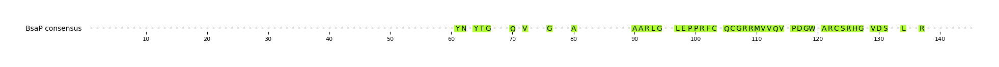

In [775]:

mv = MsaViz("final_nt_workflow/bsap_protein_subset47_edit_consensus.fa", label_type='description', show_consensus=False, color_scheme="Identity",
            # start=1, end=100,
            show_grid=False)

# mv.set_highlight_pos_by_ident_thr(min_thr=30)
mv.set_plot_params(identity_color="greenyellow", x_unit_size=0.12, y_unit_size=0.13, identity_color_min_thr=90)


# mv.set_custom_color_func(diff_consensus_color_func)
# fig = mv.plotfig()
mv.savefig("final_nt_workflow/bsap_protein_subset47_consensus.png")

## Bv-BRC based BioB MSA visualizations:

In [242]:
# biob_mfa_sorted_no_outgroup_path = "final_nt_workflow/bsap_protein_sequences_subset50.sorted.mfa"
biob_independent_msa = "motif/putative2_biob_independent_seqs_aa.mfa"

In [101]:
mv = MsaViz(biob_independent_msa, label_type='description', show_consensus=True, consensus_size=0, color_scheme="Identity")

mv.set_highlight_pos_by_ident_thr(min_thr=25)
mv.set_plot_params(identity_color="salmon")

# fig = mv.plotfig()

mv.savefig("motif/biob_independent_aa_msa.png")

In [102]:
biob_dependent_msa = ("motif/putative2_biob_dependent_seqs_aa.mfa")

mv = MsaViz(biob_dependent_msa, label_type='description', show_consensus=True, consensus_size=0, color_scheme="Identity")

mv.set_highlight_pos_by_ident_thr(min_thr=25)
mv.set_plot_params(identity_color="salmon")

# fig = mv.plotfig()

mv.savefig("motif/biob_dependent_aa_msa.png")

## MERGED subset200 BioB MSA visualizations:

In [52]:

# tree = "motif/merged_biob_seqs_subset200_protein_consensus.nwk.rooted"
# tree = "motif/merged_biob_seqs_subset200_protein_pruned2_consensus.nwk.rooted"
# tree = "motif/biob_merged_subset200_pruned_consensus_tree.nwk.rooted"
# tree = "motif/biob_merged_subset200_filter3_pruned2_consensus_tree.nwk.rooted1"
# tree = "motif/bacteria_subset503_biob_aa.msa.contree.rooted"

tree = "motif/bacteria_subset300FIX_biob_aa.msa.contree.rooted"

file = open(tree, 'r')
nwk = file.readline()
file.close()

species_order = pd.Series(nwk.split(",")).str.rstrip("\n"
    ).str.replace("_", " ").str.replace("(", " ").str.replace(")", " ").str.split(":", expand=True)[0].str.strip().tolist()


In [53]:
# msa_path = "motif/merged_biob_seqs_subset200_protein.mfa"
# sorted_msa_output_path = "motif/merged_biob_seqs_subset200_protein.sorted.mfa"

# msa_path = "motif/biob_merged_subset200_pruned.msa"
# sorted_msa_output_path = "motif/biob_merged_subset200_pruned_sorted.msa"

# msa_path = "motif/biob_merged_subset200_filter3_pruned2.msa"
# sorted_msa_output_path = "motif/biob_merged_subset200_filter3_pruned2_sorted.msa"

msa_path = "motif/bacteria_subset300FIX_biob_aa.msa"
sorted_msa_output_path = "motif/bacteria_subset300FIX_biob_aa.sorted.msa"


seqs = []
for record in SeqIO.parse(msa_path, "fasta"):
    seqs.append([record.id, record.id.replace("_", " "), record.seq])

msa = pd.DataFrame(seqs, columns=['id', 'name', 'seq'])

seqs_sorted = []
for i in species_order:
    seq = Seq(msa.loc[msa['name'] == i, 'seq'].item())
    # seq_id = msa.loc[msa['name'] == i, 'id'].item()
    seq_id = msa.loc[msa['name'] == i, 'name'].item()
    
    seqs_sorted.append(SeqRecord(seq, id=seq_id, description=""))

with open(sorted_msa_output_path, "w") as output_handle:
    SeqIO.write(seqs_sorted, output_handle, "fasta")

In [54]:
# reorder msa dataframe to match species_order:

msa = msa.set_index('name').loc[species_order].reset_index()
meta = pd.read_csv("motif/bacteria_subset300_type.csv")

# msa = msa.merge(meta[['name', 'type']], how='left', left_on='id', right_on='name', suffixes=("", "_meta"))
msa = msa.merge(meta[['id', 'type']], how='left', on='id', suffixes=("", "_meta"))

In [55]:
msa.head()

,name,id,seq,type
0,Francisella halioticida strain DSM 23729,Francisella_halioticida_strain_DSM_23729,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ...",ind
1,Coxiella-like endosymbiont of Amblyomma americ...,Coxiella-like_endosymbiont_of_Amblyomma_americ...,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ...",ind
2,Litoricola lipolytica strain IMCC 1097,Litoricola_lipolytica_strain_IMCC_1097,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ...",ind
3,Marinobacterium sp. ST58-10,Marinobacterium_sp._ST58-10,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ...",ind
4,Pseudohongiella spirulinae strain KCTC 32221,Pseudohongiella_spirulinae_strain_KCTC_32221,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ...",ind


In [56]:
# msa['name'].to_csv("motif/merged_biob_pruned2_species_order.csv", index=None)

In [57]:
## set up posisiton-based df
# consensus_seq_ind = SeqIO.read("motif/merged_biob_to_independent_subset100_protein_50consensus.fa", "fasta")
# consensus_seq_dep = SeqIO.read("motif/merged_biob_to_dependent_subset100_protein_50consensus.fa", "fasta")

# consensus_seq_ind = SeqIO.read("motif/biob_merged_to_independent_50consensus.fa", "fasta")
# consensus_seq_dep = SeqIO.read("motif/biob_merged_to_dependent_50consensus.fa", "fasta")

# consensus_seq_ind = SeqIO.read("motif/biob_merged_to_independent_editComplete_pruned_50consensus.fa", "fasta")
# consensus_seq_dep = SeqIO.read("motif/biob_merged_to_dependent_editComplete_pruned_50consensus.fa", "fasta")

# consensus_seq_ind = SeqIO.read("motif/biob_merged_to_independent_filter3_pruned2_50consensus.fa", "fasta")
# consensus_seq_dep = SeqIO.read("motif/biob_merged_to_dependent_filter3_pruned2_50consensus.fa", "fasta")

consensus_seq_ind = SeqIO.read("motif/biob_independent_subset300_consensus.fa", "fasta")
consensus_seq_dep = SeqIO.read("motif/biob_dependent_subset300_consensus.fa", "fasta")


seq_df = msa[['name', 'type', 'seq']].set_index(['name', 'type'])
seq_df = pd.DataFrame(seq_df['seq'].apply(lambda x: list(str(x))).tolist(), index=seq_df.index)
seq_df = seq_df.reset_index()

# setup biob consensus identity df:
identity = []

for i in range(len(consensus_seq_ind)):
    ind_tally = (seq_df[seq_df['type'] == 'ind'][i] == consensus_seq_ind[i]).sum()
    dep_tally = (seq_df[seq_df['type'] == 'dep'][i] == consensus_seq_dep[i]).sum()

    identity.append([i, 
                     ind_tally / (seq_df['type'] == 'ind').sum(), 
                     dep_tally / (seq_df['type'] == 'dep').sum()])

identity_df = pd.DataFrame(identity, columns=['pos', 'ind_ident', 'dep_ident']).set_index('pos')


In [58]:
## must ensure that index values of row_pos match up with consensus species indicies:

def diff_consensus_color_func(
    row_pos: int, col_pos: int, seq_char: str, msa: MultipleSeqAlignment):
    # Note: Both `row_pos` and `col_pos` are 0-index starts

    # for biob independent:
    # print(row_pos, col_pos, seq_char)
    
    if seq_df.loc[row_pos, 'type'] == 'ind':

        if seq_char == consensus_seq_ind.seq[col_pos]:
            
            identity = identity_df.loc[col_pos, 'ind_ident']
            # print('ind', row_pos, col_pos, seq_char, consensus_seq_ind.seq[col_pos], 'COLOR', identity, seq_df.loc[row_pos, 'name'])
            
            # color = lighten_color('salmon', identity)
            # return color
            
            # if identity <= 0.75:
            if identity <= 0.25:
                return None

            else:
                color = lighten_color('salmon', identity)
                # color = lighten_color("salmon", round((identity*2)-1, 2))
                # color = lighten_color("salmon", round((identity*4)-3, 2))
                return color

        else:
            # print('ind', row_pos, col_pos, seq_char, consensus_seq_ind.seq[col_pos], 'FAIL', seq_df.loc[row_pos, 'name'])
            return None

    # for biob dependent:
    else:
        
        if seq_char == consensus_seq_dep.seq[col_pos]:

            identity = identity_df.loc[col_pos, 'dep_ident']
            # print('dep', row_pos, col_pos, seq_char, consensus_seq_dep.seq[col_pos], 'COLOR', identity, seq_df.loc[row_pos, 'name'])

            # color = lighten_color('cornflowerblue', identity)
            # return color
            
            # if identity <= 0.75:
            if identity <= 0.25:
                return None

            else:
                color = lighten_color('cornflowerblue', identity)
                # color = lighten_color("cornflowerblue", round((identity*2)-1, 2))
                # color = lighten_color("cornflowerblue", round((identity*4)-3, 2))
                return color

        else:
            # print('dep', row_pos, col_pos, seq_char, consensus_seq_dep.seq[col_pos], 'FAIL', seq_df.loc[row_pos, 'name'])

            return None



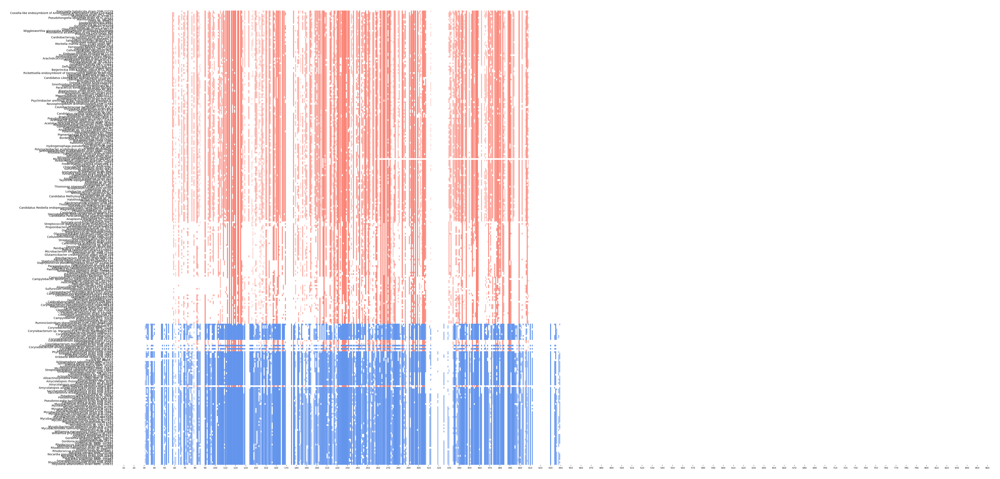

In [59]:
## PRUNED 2
mv = MsaViz(sorted_msa_output_path, label_type='description', show_consensus=False, color_scheme="None", 
            # start=1, end=100,
            show_grid=False, show_seq_char=False)

# mv.set_highlight_pos_by_ident_thr(min_thr=30)
mv.set_plot_params(x_unit_size=0.05, y_unit_size=0.08)


mv.set_custom_color_func(diff_consensus_color_func)
# fig = mv.plotfig()


mv.savefig("motif/bacteria_subset300_msa_no_char.png")

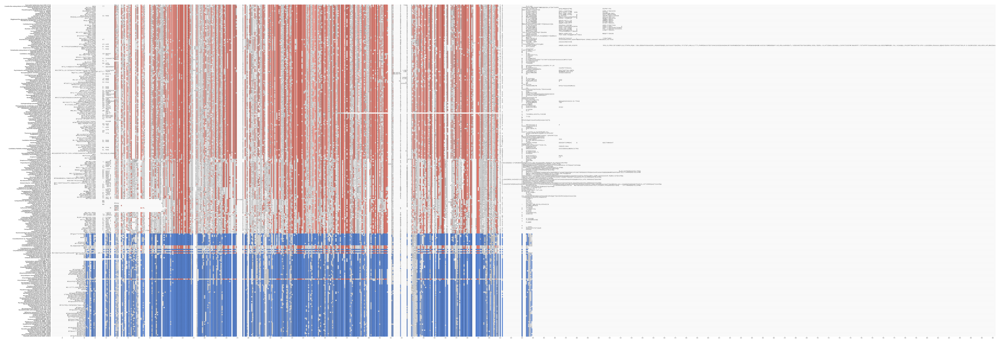

In [60]:
## PRUNED 2
mv = MsaViz(sorted_msa_output_path, label_type='description', show_consensus=False, color_scheme="None", 
            # start=1, end=100,
            show_grid=False)

# mv.set_highlight_pos_by_ident_thr(min_thr=30)
mv.set_plot_params(x_unit_size=0.12, y_unit_size=0.13)


mv.set_custom_color_func(diff_consensus_color_func)
# fig = mv.plotfig()


mv.savefig("motif/bacteria_subset300_msa_full.png")

## Look at printing out consensus sequences using msaPyViz:

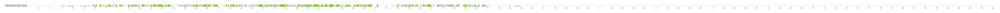

In [34]:

# mv = MsaViz("motif/pruned2_biob_consensus75.msa", label_type='description', show_consensus=False, color_scheme="Identity",
# mv = MsaViz("motif/biob_merged_subset200_consensus75_sequences.msa", label_type='description', show_consensus=False, color_scheme="Identity",
mv = MsaViz("motif/biob_subset300_consensus_seqs.msa", label_type='description', show_consensus=False, color_scheme="Identity",
            # start=1, end=100,
            show_grid=False)

# mv.set_highlight_pos_by_ident_thr(min_thr=30)
mv.set_plot_params(identity_color="greenyellow", x_unit_size=0.12, y_unit_size=0.13, identity_color_min_thr=90)


# mv.set_custom_color_func(diff_consensus_color_func)
# fig = mv.plotfig()
mv.savefig("motif/biob_subset300_compare_consensus_msa.png")

In [49]:
for i in species_order:
    print(i)

Arthrobacter enclensis strain NIO-1008
Pseudarthrobacter equi strain IMMIB L-1606
Pseudarthrobacter scleromae strain CGMCC 1.3601
Pseudarthrobacter sulfonivorans strain ALL
Paenarthrobacter aurescens strain NBRC 12136
Paenarthrobacter ureafaciens strain CZY1
Sinomonas mesophila strain MPKL 26
Aeromicrobium sp. CC-CFT486
Nocardioides zeae strain JCM 30728
Nocardioides marinus strain DSM 18248
Nocardioides islandensis strain KCTC 19275
Nocardioides agariphilus strain KCTC 19276
Nocardioides ungokensis strain LMG 28591
Marmoricola solisilvae strain KIS18-7
Dermacoccus nishinomiyaensis strain M25
Dermacoccus abyssi strain MT1.1
Dermacoccaceae bacterium C5-26
Calidifontibacter sp. DB0510
Calidifontibacter indicus strain DSM 22967
Allobranchiibius huperziae strain DSM 29531
Janibacter sp. Marseille-P4121
Tetrasphaera elongata Lp2
Phycicoccus sp. CMS6Z-2
Tetrasphaera duodecadis strain DSM 12806
Ornithinibacter aureus strain DSM 23364
Oryzihumus leptocrescens strain DSM 18082
Luteipulveratus h

## INDEPENDENT subset 100 BioB MSA visualizations:

In [103]:
# first read in order to sort alignments into:

In [181]:
# tree = "motif/putative2_biob_independent_seqs_consensus_tree.nwk_trimmed_tree_X_100"
tree = "motif/biob_independent_subset100_protein_consensus.nwk"

file = open(tree, 'r')
nwk = file.readline()
file.close()

species_order = pd.Series(nwk.split(",")).str.rstrip("\n"
    ).str.replace("_", " ").str.replace("(", " ").str.replace(")", " ").str.split(":", expand=True)[0].str.strip().tolist()

In [182]:
len(species_order)

100

In [183]:
msa_path = "motif/biob_independent_subset100_protein.mfa"
sorted_msa_output_path = "motif/biob_independent_subset100_protein.sorted.mfa"

seqs = []
for record in SeqIO.parse(msa_path, "fasta"):
    seqs.append([record.id, record.id.replace("_", " "), record.seq])

msa = pd.DataFrame(seqs, columns=['id', 'name', 'seq'])


seqs_sorted = []
for i in species_order:
    seq = Seq(msa.loc[msa['name'] == i, 'seq'].item())
    seq_id = msa.loc[msa['name'] == i, 'name'].item()
    
    seqs_sorted.append(SeqRecord(seq, id=seq_id, description=""))

# with open(sorted_msa_output_path, "w") as output_handle:
#     SeqIO.write(seqs_sorted, output_handle, "fasta")

In [196]:
genomes = pd.read_csv("motif/actinomycetota_bvbrc_reference_genomes.csv")
genomes = genomes[['Genome Name', 'NCBI Taxon ID', 'Genome ID', 'Order', 'Family', 'Genus']]


In [200]:
genomes[genomes['Genome Name'].str.contains('Solirub')]

,Genome Name,NCBI Taxon ID,Genome ID,Order,Family,Genus
935,Solirubrobacter pauli strain DSM 14954,166793,166793.3,Solirubrobacterales,Solirubrobacteraceae,Solirubrobacter
2164,Solirubrobacterales bacterium 0166_1,2884022,2884022.3,Solirubrobacterales,Capillimicrobiaceae,Capillimicrobium


In [205]:
species_order = pd.Series(species_order).str.replace("0166 1", "0166_1")

In [207]:
genomes.set_index("Genome Name").loc[species_order].to_csv("motif/biob_independent_subset100_genome_metadata.csv")

In [136]:
msa.head()

,id,name,seq
0,Ornithinimicrobium_tianjinense_strain_CGMCC_1....,Ornithinimicrobium tianjinense strain CGMCC 1....,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
1,Sphaerimonospora_thailandensis_strain_NBRC_107569,Sphaerimonospora thailandensis strain NBRC 107569,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
2,Conexibacter_sp._Seoho-28,Conexibacter sp. Seoho-28,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
3,Conexibacter_arvalis_strain_DSM_23288,Conexibacter arvalis strain DSM 23288,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."
4,Nitriliruptor_alkaliphilus_DSM_45188,Nitriliruptor alkaliphilus DSM 45188,"(-, -, -, -, -, -, -, -, -, -, -, -, -, -, -, ..."


In [ ]:
independent_sorted_msa_output_path = "motif/biob_independent_subset100_protein.sorted.mfa"

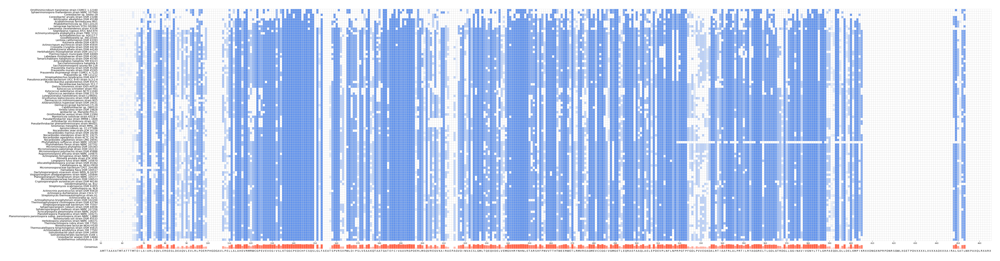

In [137]:
mv = MsaViz(independent_sorted_msa_output_path, label_type='description', show_consensus=True, color_scheme="Identity", consensus_color="tomato",
           start=50, end=465, 
            show_seq_char=False, show_grid=True)

# mv.set_highlight_pos_by_ident_thr(min_thr=30)
mv.set_plot_params(identity_color="cornflowerblue", x_unit_size=0.12, y_unit_size=0.13, identity_color_min_thr=10)

fig = mv.plotfig()

# mv.savefig("motif/biob_independent_subset100_no_seq.png")

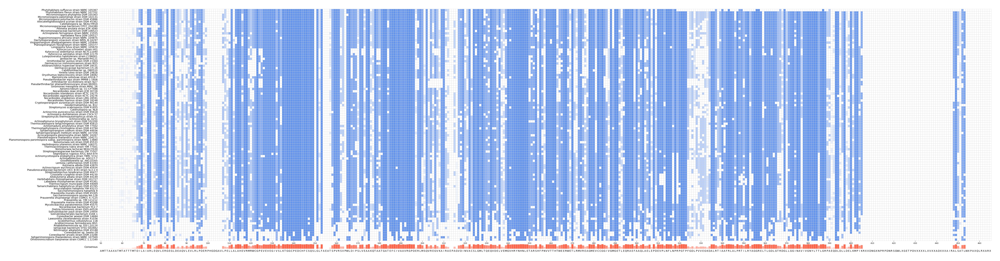

In [138]:
mv = MsaViz(independent_sorted_msa_output_path, label_type='description', show_consensus=True, color_scheme="Identity", consensus_color="tomato",
           start=50, end=465, 
            show_seq_char=False, show_grid=True, sort=True)

# mv.set_highlight_pos_by_ident_thr(min_thr=30)
mv.set_plot_params(identity_color="cornflowerblue", x_unit_size=0.12, y_unit_size=0.13, identity_color_min_thr=10)

fig = mv.plotfig()

# mv.savefig("motif/biob_independent_subset100_no_seq.png")

## DEPENDENT subset 100 BioB MSA visualizations:

In [208]:
# tree = "motif/putative2_biob_dependent_seqs_consensus_tree.nwk_trimmed_tree_X_100"
tree = "motif/biob_dependent_subset100_protein_consensus.nwk"

file = open(tree, 'r')
nwk = file.readline()
file.close()

species_order = pd.Series(nwk.split(",")).str.rstrip("\n"
    ).str.replace("_", " ").str.replace("(", " ").str.replace(")", " ").str.split(":", expand=True)[0].str.strip().tolist()

In [214]:
msa_path = "motif/biob_dependent_subset100_protein.mfa"
sorted_msa_output_path = "motif/biob_dependent_subset100_protein.sorted.mfa"

seqs = []
for record in SeqIO.parse(msa_path, "fasta"):
    seqs.append([record.id, record.id.replace("_", " "), record.seq])

msa = pd.DataFrame(seqs, columns=['id', 'name', 'seq'])


# seqs_sorted = []
# for i in species_order:
#     seq = Seq(msa.loc[msa['name'] == i, 'seq'].item())
#     seq_id = msa.loc[msa['name'] == i, 'name'].item()
    
#     seqs_sorted.append(SeqRecord(seq, id=seq_id, description=""))


# with open(sorted_msa_output_path, "w") as output_handle:
#     SeqIO.write(seqs_sorted, output_handle, "fasta")

In [215]:
dependent_sorted_msa_output_path = "motif/biob_dependent_subset100_protein.sorted.mfa"


In [219]:
genomes[genomes['Genome Name'].str.contains('smegmatis')]

,Genome Name,NCBI Taxon ID,Genome ID,Order,Family,Genus
1047,Mycolicibacterium smegmatis strain FDAARGOS_679,1772,1772.43,Corynebacteriales,Mycobacteriaceae,Mycolicibacterium


In [217]:
species_order = pd.Series(species_order).str.replace("FDAARGOS 1493", "FDAARGOS_1493")

In [220]:
species_order = pd.Series(species_order).str.replace("FDAARGOS 679", "FDAARGOS_679")

In [222]:


genomes.set_index("Genome Name").loc[species_order].to_csv("motif/biob_dependent_subset100_genome_metadata.csv")

In [223]:
genomes.set_index("Genome Name").loc[species_order]

,NCBI Taxon ID,Genome ID,Order,Family,Genus
Genome Name,,,,,
Actinomadura madurae strain NCTC11373,1993,1993.60,Streptosporangiales,Thermomonosporaceae,Actinomadura
Nocardia sp. YIM PH 21724,2340916,2340916.30,Corynebacteriales,Nocardiaceae,Nocardia
Kribbella jejuensis strain DSM 17305,236068,236068.30,Propionibacteriales,Kribbellaceae,Kribbella
Nocardia sp. ET3-3,2675851,2675851.30,Corynebacteriales,Nocardiaceae,Nocardia
Mycobacterium sp. M1,2835306,2835306.30,Corynebacteriales,Mycobacteriaceae,Mycolicibacterium
...,...,...,...,...,...
Tsukamurella paurometabola DSM 20162,521096,521096.60,Corynebacteriales,Tsukamurellaceae,Tsukamurella
Mycobacterium haemophilum DSM 44634 ATCC 29548,1202450,1202450.13,Corynebacteriales,Mycobacteriaceae,Mycobacterium
Mycobacterium triplex strain DSM 44626,47839,47839.70,Corynebacteriales,Mycobacteriaceae,Mycobacterium


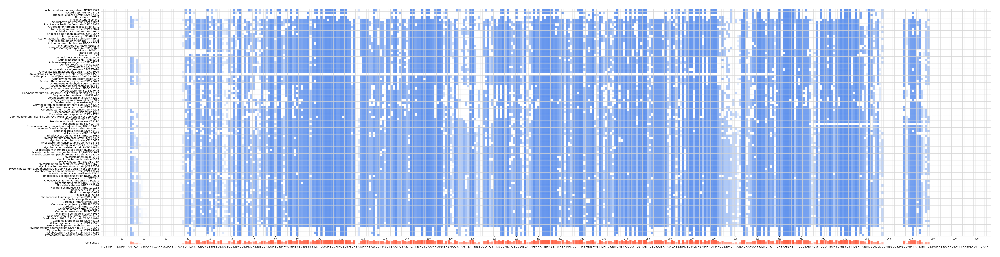

In [130]:
mv = MsaViz(dependent_sorted_msa_output_path, label_type='description', show_consensus=True, color_scheme="Identity", consensus_color="tomato",
           # start=50, end=465, 
            show_seq_char=False, show_grid=True)

# mv.set_highlight_pos_by_ident_thr(min_thr=30)
mv.set_plot_params(identity_color="cornflowerblue", x_unit_size=0.12, y_unit_size=0.13, identity_color_min_thr=10)

fig = mv.plotfig()

# mv.savefig("motif/biob_independent_subset100_no_seq.png")

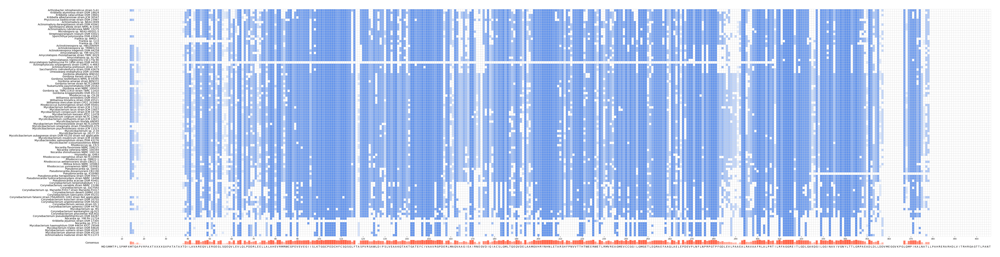

In [132]:
mv = MsaViz(dependent_sorted_msa_output_path, label_type='description', show_consensus=True, color_scheme="Identity", consensus_color="tomato",
           # start=50, end=465, 
            show_seq_char=False, show_grid=True, sort=True)

# mv.set_highlight_pos_by_ident_thr(min_thr=30)
mv.set_plot_params(identity_color="cornflowerblue", x_unit_size=0.12, y_unit_size=0.13, identity_color_min_thr=10)

fig = mv.plotfig()

# mv.savefig("motif/biob_independent_subset100_no_seq.png")

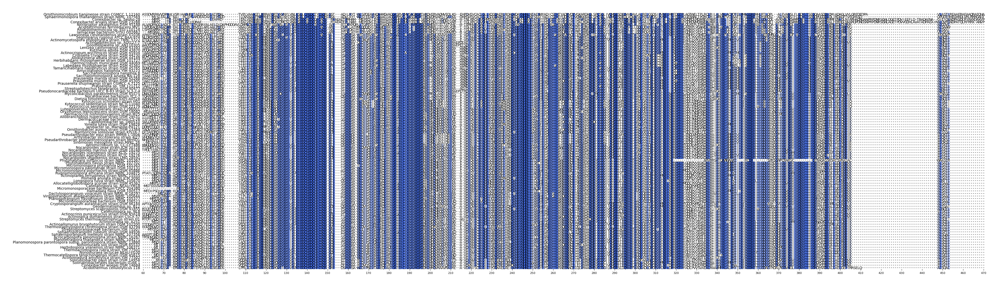

In [239]:

mv = MsaViz(independent_sorted_msa_output_path, label_type='description', color_scheme="Identity",
           start=60, end=470,
            consensus_size=50, show_seq_char=True, show_grid=False, show_label=True)

mv.set_highlight_pos_by_ident_thr(min_thr=75)
mv.set_plot_params(identity_color="royalblue", x_unit_size=0.08, y_unit_size=0.1, identity_color_min_thr=75)

# fig = mv.plotfig()

mv.savefig("motif/biob_independent_subset100_seq.png")

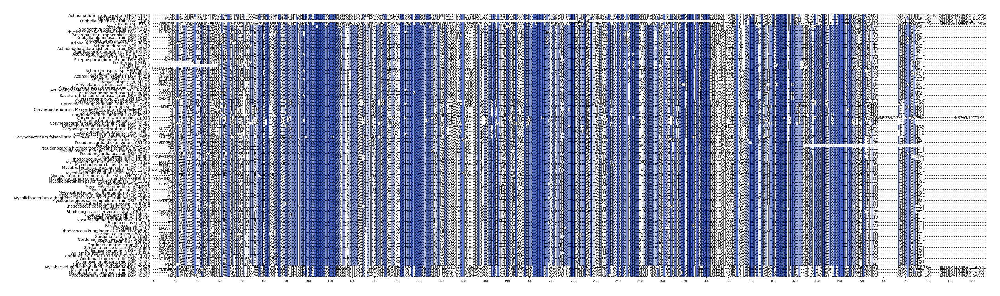

In [241]:

mv = MsaViz(dependent_sorted_msa_output_path, label_type='description', color_scheme="Identity",
            start=30, 
            consensus_size=50, show_seq_char=True, show_grid=False, show_label=True)

mv.set_highlight_pos_by_ident_thr(min_thr=75)
mv.set_plot_params(identity_color="royalblue", x_unit_size=0.08, y_unit_size=0.1, identity_color_min_thr=75)

# fig = mv.plotfig()

mv.savefig("motif/biob_dependent_subset100_seq.png")